# III/ Modélisation avec l'algorithme CNN

## III.1) Classification Binaire

Epoch 1/50
7/7 [==============================] - 16s 2s/step - loss: 34.5675 - accuracy: 0.5073 - val_loss: 46.9098 - val_accuracy: 0.5217
Epoch 2/50
7/7 [==============================] - 16s 2s/step - loss: 8.2112 - accuracy: 0.5854 - val_loss: 27.5215 - val_accuracy: 0.7391
Epoch 3/50
7/7 [==============================] - 16s 2s/step - loss: 4.5137 - accuracy: 0.6488 - val_loss: 52.8005 - val_accuracy: 0.5217
Epoch 4/50
7/7 [==============================] - 16s 2s/step - loss: 3.7871 - accuracy: 0.7268 - val_loss: 9.0562 - val_accuracy: 0.6522
Epoch 5/50
7/7 [==============================] - 16s 2s/step - loss: 1.9546 - accuracy: 0.7854 - val_loss: 4.9037 - val_accuracy: 0.5652
Epoch 6/50
7/7 [==============================] - 16s 2s/step - loss: 1.1036 - accuracy: 0.8098 - val_loss: 2.3677 - val_accuracy: 0.6087
Epoch 7/50
7/7 [==============================] - 16s 2s/step - loss: 0.9737 - accuracy: 0.8195 - val_loss: 1.3280 - val_accuracy: 0.6957
Epoch 8/50
7/7 [==============

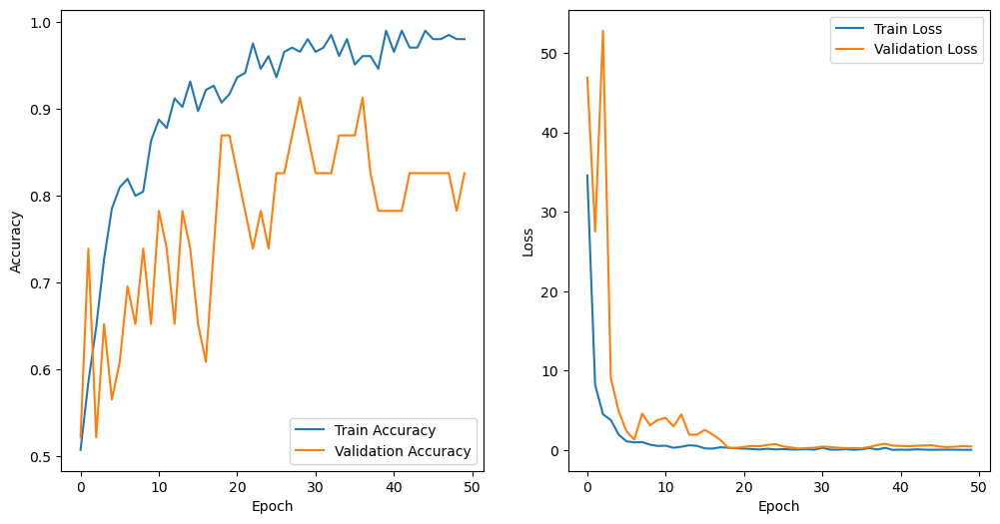

In [16]:
import os
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from scipy.ndimage import zoom

# Function to load and preprocess NIfTI images
def load_and_preprocess_images_nifti_batch(image_paths, target_size):
    images = []
    for image_path in image_paths:
        img = nib.load(image_path).get_fdata()
        img_resized = zoom(img, target_size / np.array(img.shape), order=1)
        images.append(img_resized)
    return np.array(images)

# Set directories and file paths
image_dir = 'E:/StageEsprit/ADNI_CNN_Transfer_Autoencoder/annual_screening/annual/ADNI/CN,AD,MCI'
excel_path = 'E:/StageEsprit/ADNI_CNN_Transfer_Autoencoder/ADNI1_Annual_2_Yr_3T_8_05_2023 - Copie.xlsx'

# Load labels from Excel file
df = pd.read_excel(excel_path)

# List of allowed image extensions
image_extensions = ['.nii', '.nii.gz']

# List to store image paths
image_paths = []

# Collect image paths from the directory
for file_name in os.listdir(image_dir):
    if any(file_name.lower().endswith(ext) for ext in image_extensions):
        image_path = os.path.join(image_dir, file_name)
        image_paths.append(image_path)

# Target size for image resizing
target_size_reduced = (224, 224, 3)

# Batch size for loading images
batch_size = 5

# Split image paths into batches
image_batches = [image_paths[i:i + batch_size] for i in range(0, len(image_paths), batch_size)]

# Load and preprocess images in batches
images_nifti = []
y_labels = []

for batch_paths in image_batches:
    batch_images = load_and_preprocess_images_nifti_batch(batch_paths, target_size_reduced)
    images_nifti.append(batch_images)

    for image_path in batch_paths:
        image_name = os.path.splitext(os.path.basename(image_path))[0]
        matching_rows = df[df['Subject'].str.contains(image_name)]['Group']
        if len(matching_rows) > 0:
            label = matching_rows.values[0]
            if label == 'CN':
                y_labels.append(0)
            else:
                y_labels.append(1)

images_nifti = np.concatenate(images_nifti, axis=0)
y_labels = np.array(y_labels)

# Split data into train and test sets
train_images, test_images, y_train, y_test = train_test_split(images_nifti, y_labels, test_size=0.4, random_state=42)

# Build a CNN Model with BatchNormalization and Dropout
cnn_model = tf.keras.Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(1, activation='sigmoid')
])

# Compile the CNN model
cnn_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                  loss='binary_crossentropy', metrics=['accuracy'])

# Train the CNN model
history = cnn_model.fit(train_images, y_train, batch_size=32, epochs=50, shuffle=True, validation_split=0.1)

# Evaluate the CNN model on test data
test_loss, test_accuracy = cnn_model.evaluate(test_images, y_test)
print("Test Accuracy:", test_accuracy)

# Make predictions on test data
y_pred = cnn_model.predict(test_images)
y_pred_binary = (y_pred > 0.5).astype(int).flatten()

# Calculate evaluation metrics
accuracy = accuracy_score(y_test, y_pred_binary)
precision = precision_score(y_test, y_pred_binary)
recall = recall_score(y_test, y_pred_binary)
f1 = f1_score(y_test, y_pred_binary)
conf_matrix = confusion_matrix(y_test, y_pred_binary)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)
print("Confusion Matrix:")
print(conf_matrix)

# Plot accuracy and loss curves
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.show()


In [21]:
# Make predictions on test data
y_pred = cnn_model.predict(test_images)
y_pred_binary = (y_pred > 0.5).astype(int).flatten()

# Display images with predictions
display_width = 8
display_height = 10
num_cols = 8
num_rows = 15

n = len(test_images)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(display_width * num_cols, display_height * num_rows))

for i, ax in enumerate(axes.flat):
    if i < n:
        # Convert RGB image to grayscale
        grayscale_img = rgb_to_grayscale(test_images[i])
        ax.imshow(grayscale_img, cmap='gray')  # Display in grayscale colormap
        ax.set_title(f"Prediction: {'Alzheimer' if y_pred_binary[i] == 1 else 'Non-Alzheimer (CN)'}", fontsize=35)
        ax.axis('off')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()


5/5 [==============================] - 2s 371ms/step


## III.2) Classification Multiclasse


Epoch 1/50
7/7 [==============================] - 15s 2s/step - loss: 5.4769 - accuracy: 0.4293 - val_loss: 4.0592 - val_accuracy: 0.2609
Epoch 2/50
7/7 [==============================] - 15s 2s/step - loss: 1.3245 - accuracy: 0.6244 - val_loss: 6.8232 - val_accuracy: 0.4783
Epoch 3/50
7/7 [==============================] - 16s 2s/step - loss: 1.0358 - accuracy: 0.7805 - val_loss: 1.9335 - val_accuracy: 0.5217
Epoch 4/50
7/7 [==============================] - 16s 2s/step - loss: 0.7325 - accuracy: 0.7610 - val_loss: 2.1389 - val_accuracy: 0.3913
Epoch 5/50
7/7 [==============================] - 15s 2s/step - loss: 0.4844 - accuracy: 0.8488 - val_loss: 3.1996 - val_accuracy: 0.5217
Epoch 6/50
7/7 [==============================] - 16s 2s/step - loss: 0.3998 - accuracy: 0.8780 - val_loss: 2.1462 - val_accuracy: 0.5652
Epoch 7/50
7/7 [==============================] - 16s 2s/step - loss: 0.2375 - accuracy: 0.9366 - val_loss: 1.4164 - val_accuracy: 0.6957
Epoch 8/50
7/7 [==================

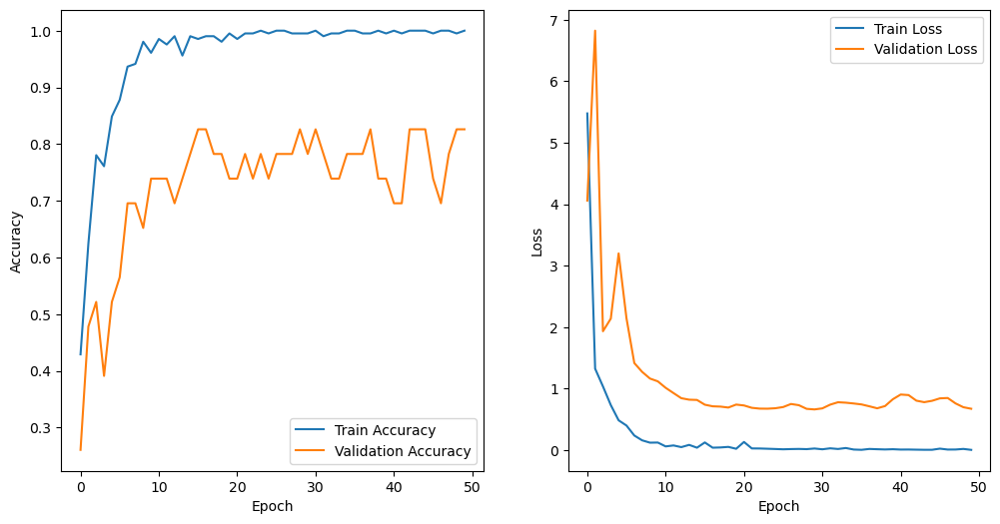

In [15]:
import os
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization  # Ajout de BatchNormalization
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from scipy.ndimage import zoom
import warnings

# Function to load and preprocess NIfTI images
def load_and_preprocess_images_nifti_batch(image_paths, target_size):
    images = []
    for image_path in image_paths:
        img = nib.load(image_path).get_fdata()
        img_resized = zoom(img, target_size / np.array(img.shape), order=1)
        images.append(img_resized)
    return np.array(images)

# Set directories and file paths
image_dir = 'E:/StageEsprit/ADNI_CNN_Transfer_Autoencoder/annual_screening/annual/ADNI/CN,AD,MCI'
excel_path = 'E:/StageEsprit/ADNI_CNN_Transfer_Autoencoder/ADNI1_Annual_2_Yr_3T_8_05_2023 - Copie.xlsx'

# Load labels from Excel file
df = pd.read_excel(excel_path)

# List of allowed image extensions
image_extensions = ['.nii', '.nii.gz']

# List to store image paths
image_paths = []

# Collect image paths from the directory
for file_name in os.listdir(image_dir):
    if any(file_name.lower().endswith(ext) for ext in image_extensions):
        image_path = os.path.join(image_dir, file_name)
        image_paths.append(image_path)

# Target size for image resizing
target_size_reduced = (224, 224, 3)

# Batch size for loading images
batch_size = 5

# Split image paths into batches
image_batches = [image_paths[i:i + batch_size] for i in range(0, len(image_paths), batch_size)]

# Load and preprocess images in batches
images_nifti = []
y_labels = []

for batch_paths in image_batches:
    batch_images = load_and_preprocess_images_nifti_batch(batch_paths, target_size_reduced)
    images_nifti.append(batch_images)

    for image_path in batch_paths:
        image_name = os.path.splitext(os.path.basename(image_path))[0]
        matching_rows = df[df['Subject'].str.contains(image_name)]['Group']
        if len(matching_rows) > 0:
            label = matching_rows.values[0]
            if label == 'CN':
                y_labels.append(0)
            elif label == 'AD':
                y_labels.append(1)
            else:
                y_labels.append(2)

images_nifti = np.concatenate(images_nifti, axis=0)
y_labels = np.array(y_labels)

# Split data into train and test sets
train_images, test_images, y_train, y_test = train_test_split(images_nifti, y_labels, test_size=0.4, random_state=42)

# Build a CNN Model
cnn_model = tf.keras.Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    BatchNormalization(),  # Couche de Batch Normalization
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    BatchNormalization(),  # Couche de Batch Normalization
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    BatchNormalization(),  # Couche de Batch Normalization
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.5),  # Couche de Dropout
    Dense(3, activation='softmax')
])


# Compile the CNN model
cnn_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
                  loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the CNN model
history = cnn_model.fit(train_images, y_train, batch_size=32, epochs=50, shuffle=True, validation_split=0.1)

# Evaluate the CNN model on test data
test_loss, test_accuracy = cnn_model.evaluate(test_images, y_test)
print("Test Accuracy:", test_accuracy)

# Make predictions on test data
y_pred = cnn_model.predict(test_images)
y_pred_classes = np.argmax(y_pred, axis=1)

# Calculate evaluation metrics
accuracy = accuracy_score(y_test, y_pred_classes)
precision = precision_score(y_test, y_pred_classes, average='macro', zero_division=1)
recall = recall_score(y_test, y_pred_classes, average='macro', zero_division=1)
f1 = f1_score(y_test, y_pred_classes, average='macro', zero_division=1)
conf_matrix = confusion_matrix(y_test, y_pred_classes)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)
print("Confusion Matrix:")
print(conf_matrix)


print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)
print("Confusion Matrix:")
print(conf_matrix)

# Plot accuracy and loss curves
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.show()


In [46]:
# Make predictions on test data
y_pred = cnn_model.predict(test_images)
y_pred_classes = np.argmax(y_pred, axis=1)

# Display images with predictions
display_width = 8
display_height = 10
num_cols = 8
num_rows = 15

n = len(test_images)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(display_width * num_cols, display_height * num_rows))

class_labels = {0: 'Non Alzheimer (CN)', 1: 'Alzheimer (AD)', 2: 'Alzheimer (MCI)'}

for i, ax in enumerate(axes.flat):
    if i < n:
        # Convert RGB image to grayscale
        grayscale_img = rgb_to_grayscale(test_images[i])
        ax.imshow(grayscale_img, cmap='gray')  # Display in grayscale colormap
        ax.set_title(f"Predicted: {class_labels[y_pred_classes[i]]}", fontsize=35)
        ax.axis('off')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()
